## Importar librerías

In [340]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

## Leer imágenes del dataset "The Dark Face"

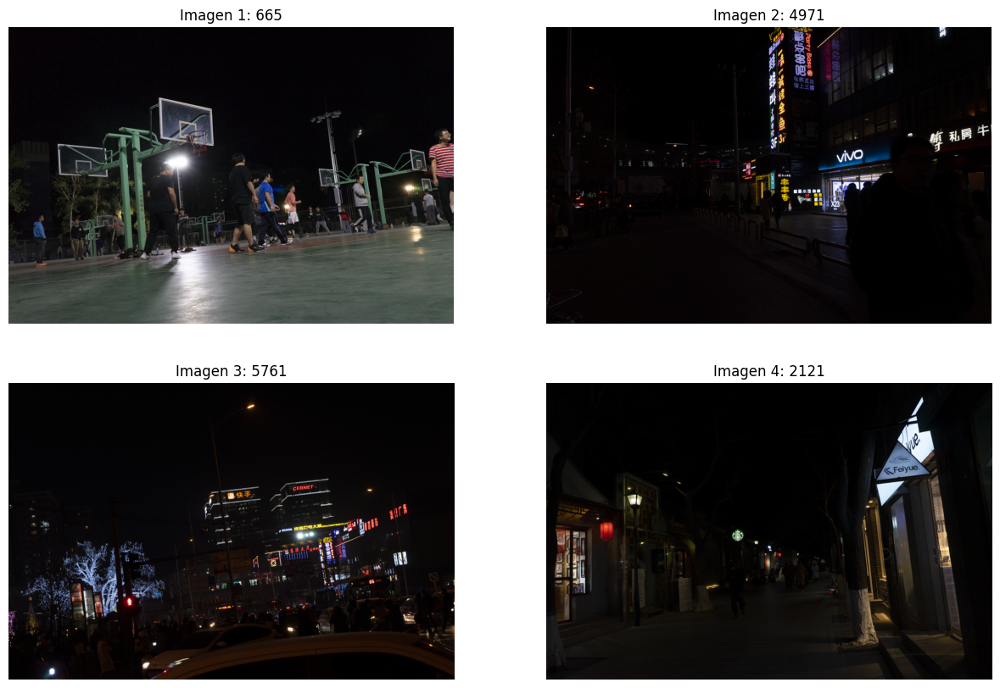

In [341]:
import random

random.seed(89)

nfig1 = random.randint(1,6000)
nfig2 = random.randint(1,6000)
nfig3 = random.randint(1,6000)
nfig4 = random.randint(1,6000)

img1 = cv2.imread(f'{nfig1}.jpg')
img2 = cv2.imread(f'{nfig2}.jpg')
img3 = cv2.imread(f'{nfig3}.jpg')
img4 = cv2.imread(f'{nfig4}.jpg')

rgb_1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
rgb_2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)
rgb_3 = cv2.cvtColor(img3, cv2.COLOR_BGR2RGB)
rgb_4 = cv2.cvtColor(img4, cv2.COLOR_BGR2RGB)

# Trabajar con Luminancia
yuv_1 = cv2.cvtColor(img1, cv2.COLOR_BGR2YUV) 
yuv_2 = cv2.cvtColor(img2, cv2.COLOR_BGR2YUV) 
yuv_3 = cv2.cvtColor(img3, cv2.COLOR_BGR2YUV) 
yuv_4 = cv2.cvtColor(img4, cv2.COLOR_BGR2YUV) 

plt.figure(figsize=(15, 10))
plt.subplot(2,2,1), plt.title(f'Imagen 1: {nfig1}'), plt.imshow(rgb_1), plt.axis('off')
plt.subplot(2,2,2), plt.title(f'Imagen 2: {nfig2}'), plt.imshow(rgb_2), plt.axis('off')
plt.subplot(2,2,3), plt.title(f'Imagen 3: {nfig3}'), plt.imshow(rgb_3), plt.axis('off')
plt.subplot(2,2,4), plt.title(f'Imagen 4: {nfig4}'), plt.imshow(rgb_4), plt.axis('off')
plt.show()



## Imagen 1

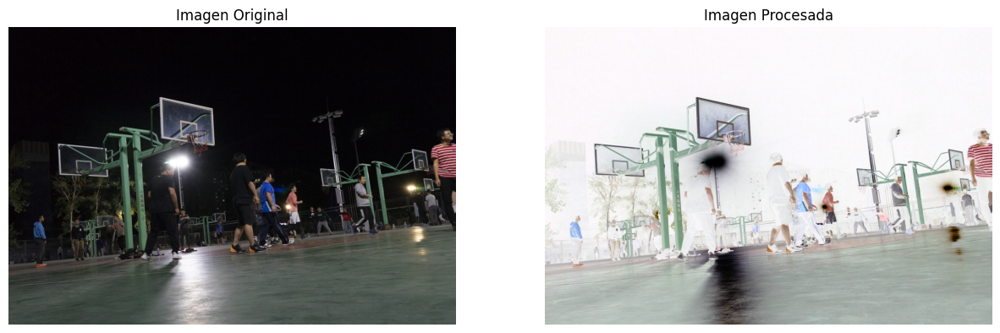

In [342]:
# negativo
yuv_1_c = yuv_1.copy()
yuv_1_c[:,:,0] = 255-yuv_1_c[:,:,0]


rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_1), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

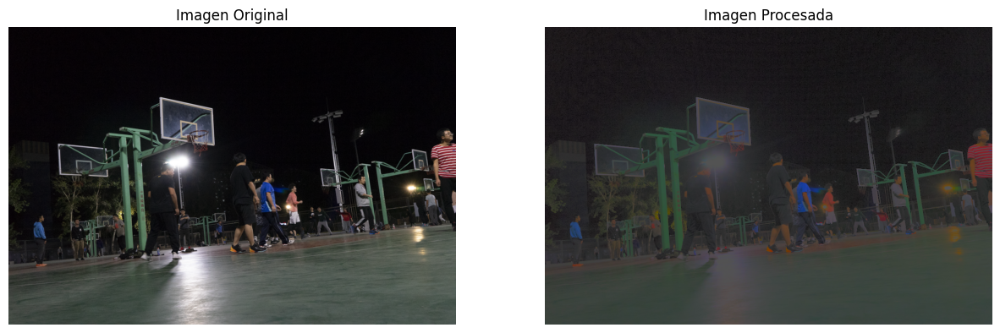

In [343]:
# transformación logaritmica
yuv_1_c = yuv_1.copy()
# c = 255 / np.log(1 + np.max(yuv_1_c[:,:,0])) 
c=15
yuv_1_c[:,:,0] = c * np.log(1 + yuv_1_c[:,:,0].astype(float))
yuv_1_c[:,:,0] = np.array(yuv_1_c[:,:,0],dtype=np.uint8)

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_1), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()


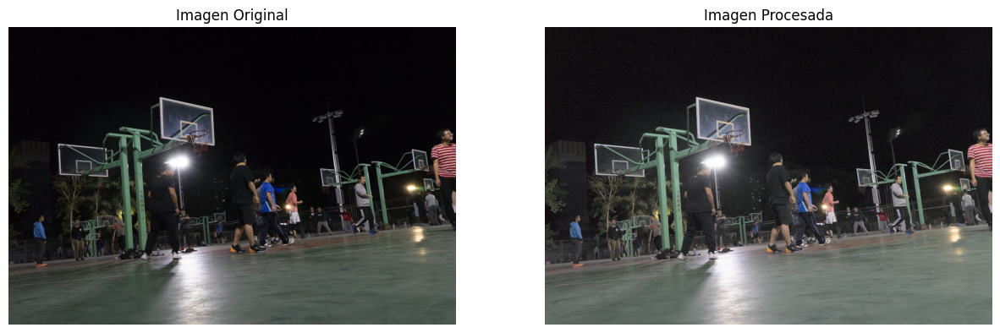

In [344]:
# Ley de potencia (gamma)
yuv_1_c = yuv_1.copy()
gamma = 0.7  # Ajustar este valor
c = 255 / (np.max(yuv_1_c[:,:,0]) ** gamma) 
yuv_1_c[:,:,0] = c * (yuv_1_c[:,:,0].astype(float) ** gamma)
yuv_1_c[:,:,0] = np.array(yuv_1_c[:,:,0], dtype=np.uint8)

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_1), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

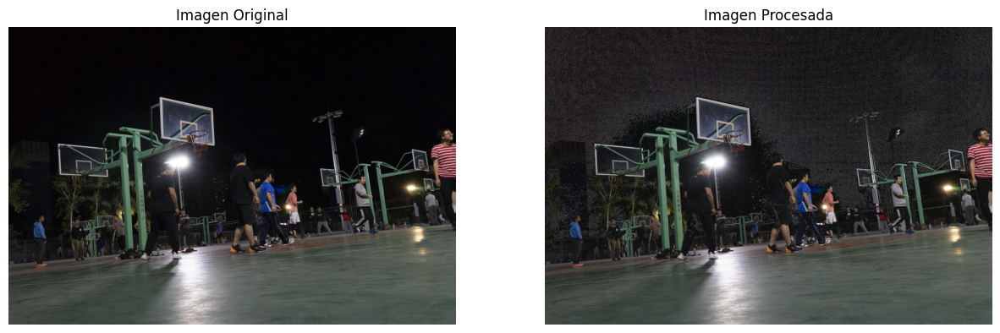

In [345]:
# Función personalizada 1 (transformación lineal por tramos)
def custom_transform(pixel):
    if pixel < 10:
        return int(7 * pixel)  # Reducir intensidad en áreas oscuras
    else:
        return pixel  # Mantener sin cambios

yuv_1_c = yuv_1.copy()
yuv_1_c[:,:,0] = np.array([custom_transform(pixel) for row in yuv_1_c[:,:,0] for pixel in row]).reshape(yuv_1_c[:,:,0].shape)
yuv_1_c[:,:,0] = np.array(yuv_1_c[:,:,0], dtype=np.uint8)

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_1), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

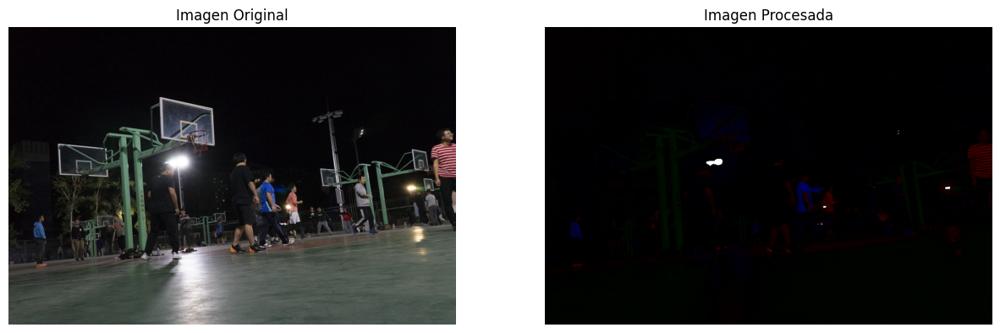

In [346]:
# Función personalizada 2 (transformación basada en seno)
yuv_1_c = yuv_1.copy()

yuv_1_c[:,:,0] = yuv_1_c[:,:,0].astype(np.float32) / 255.0 
yuv_1_c[:,:,0] = 255 * np.sin(np.pi / 2 * yuv_1_c[:,:,0]) 
yuv_1_c[:,:,0] = np.uint8(yuv_1_c[:,:,0])

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_1), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

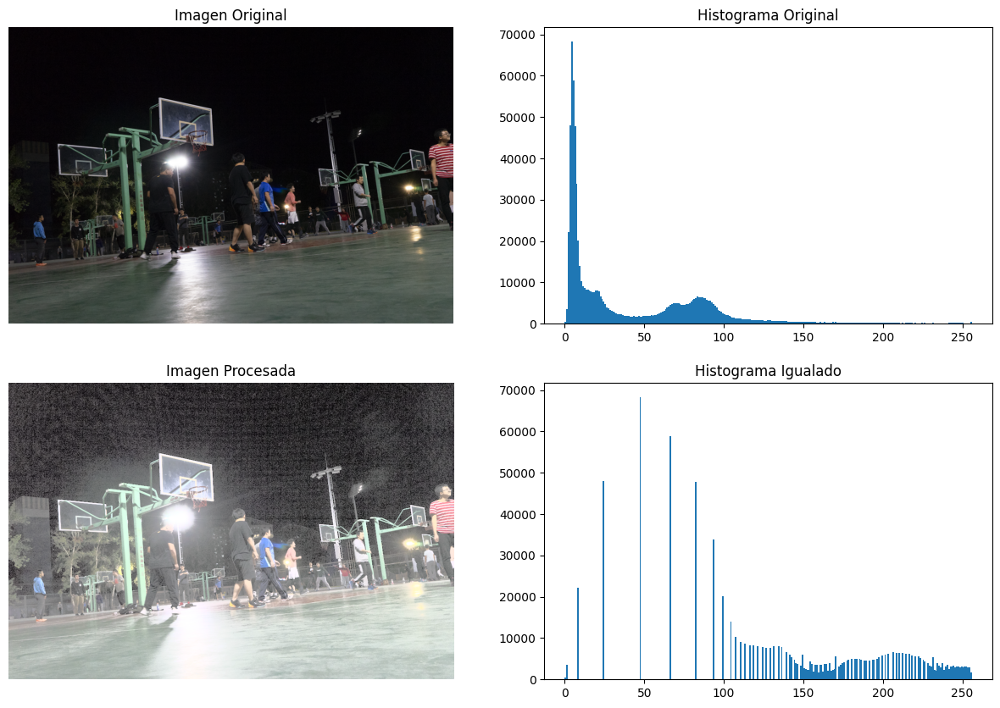

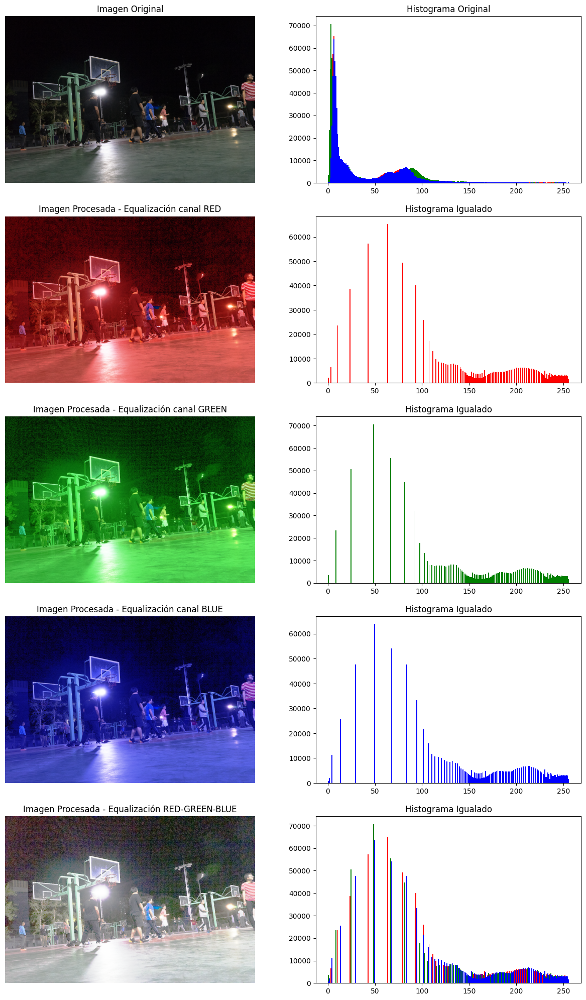

In [347]:
# Igualación del histograma
yuv_1_c = yuv_1.copy()
yuv_1_c[:,:,0] = cv2.equalizeHist(yuv_1_c[:,:,0])

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(2,2,1), plt.title('Imagen Original'), plt.imshow(rgb_1), plt.axis('off')
plt.subplot(2,2,2), plt.title('Histograma Original'), plt.hist(yuv_1[:,:,0].ravel(), 256, range=[0, 256])
plt.subplot(2,2,3), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.subplot(2,2,4), plt.title('Histograma Igualado'), plt.hist(yuv_1_c[:,:,0].ravel(), 256, range=[0, 256])
plt.show()

# RED
rgb_1_r = rgb_1.copy()
rgb_1_r[:,:,0] = cv2.equalizeHist(rgb_1_r[:,:,0])
# GREEN
rgb_1_g = rgb_1.copy()
rgb_1_g[:,:,1] = cv2.equalizeHist(rgb_1_g[:,:,1])
# BLUE
rgb_1_b = rgb_1.copy()
rgb_1_b[:,:,2] = cv2.equalizeHist(rgb_1_b[:,:,2])
# RGB
rgb_1_c = rgb_1.copy()
rgb_1_c[:,:,0] = cv2.equalizeHist(rgb_1_c[:,:,0])
rgb_1_c[:,:,1] = cv2.equalizeHist(rgb_1_c[:,:,1])
rgb_1_c[:,:,2] = cv2.equalizeHist(rgb_1_c[:,:,2])

plt.figure(figsize=(15, 25))
plt.subplot(5,2,1), plt.title('Imagen Original'), plt.imshow(rgb_1), plt.axis('off')
plt.subplot(5,2,2), plt.title('Histograma Original'), plt.hist(rgb_1[:,:,0].ravel(), 256, range=[0, 256],color='r'), plt.hist(rgb_1[:,:,1].ravel(), 256, range=[0, 256],color='g'), plt.hist(rgb_1[:,:,2].ravel(), 256, range=[0, 256],color='b')
plt.subplot(5,2,3), plt.title('Imagen Procesada - Equalización canal RED'), plt.imshow(rgb_1_r), plt.axis('off')
plt.subplot(5,2,4), plt.title('Histograma Igualado'), plt.hist(rgb_1_r[:,:,0].ravel(), 256, range=[0, 256],color='r')
plt.subplot(5,2,5), plt.title('Imagen Procesada - Equalización canal GREEN'), plt.imshow(rgb_1_g), plt.axis('off')
plt.subplot(5,2,6), plt.title('Histograma Igualado'), plt.hist(rgb_1_g[:,:,1].ravel(), 256, range=[0, 256],color='g')
plt.subplot(5,2,7), plt.title('Imagen Procesada - Equalización canal BLUE'), plt.imshow(rgb_1_b), plt.axis('off')
plt.subplot(5,2,8), plt.title('Histograma Igualado'), plt.hist(rgb_1_b[:,:,2].ravel(), 256, range=[0, 256],color='b')
plt.subplot(5,2,9), plt.title('Imagen Procesada - Equalización RED-GREEN-BLUE'), plt.imshow(rgb_1_c), plt.axis('off')
plt.subplot(5,2,10), plt.title('Histograma Igualado'), plt.hist(rgb_1_c[:,:,0].ravel(), 256, range=[0, 256],color='r'), plt.hist(rgb_1_c[:,:,1].ravel(), 256, range=[0, 256],color='g'), plt.hist(rgb_1_c[:,:,2].ravel(), 256, range=[0, 256],color='b')
plt.show()

In [ ]:
# Realce de detalles mediante sustracción

yuv_1_c = yuv_1.copy()
yuv_1_c[:,:,0] = cv2.GaussianBlur(yuv_1_c[:,:,0], (15,15), 0)
yuv_1_c[:,:,0] = cv2.subtract(yuv_1[:,:,0], yuv_1_c[:,:,0])

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_1), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

In [ ]:
# Eliminación de ruido mediante promediado

yuv_1_c = yuv_1.copy()
yuv_1_c[:,:,0] = cv2.blur(yuv_1_c[:,:,0], (5, 5))

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_1), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

## Imagen 2

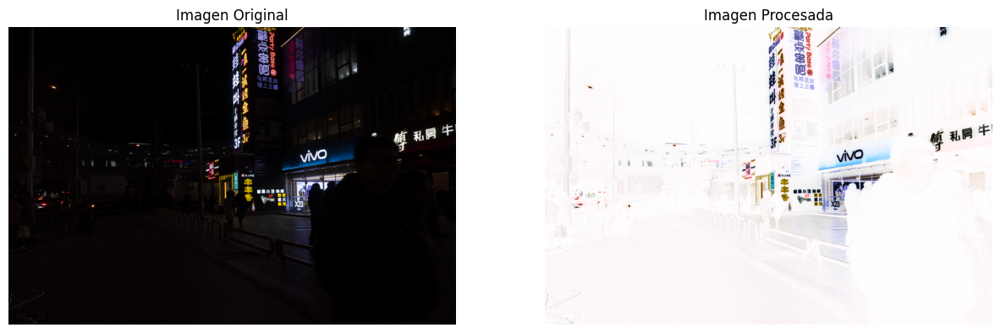

In [350]:
# negativo
yuv_1_c = yuv_2.copy()
yuv_1_c[:,:,0] = 255-yuv_1_c[:,:,0]


rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_2), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

C:\Users\wrfig\AppData\Local\Temp\ipykernel_10500\1285793294.py:3: RuntimeWarning: overflow encountered in scalar add
  c = 255 / np.log(1 + np.max(yuv_1_c[:,:,0]))
C:\Users\wrfig\AppData\Local\Temp\ipykernel_10500\1285793294.py:3: RuntimeWarning: divide by zero encountered in log
  c = 255 / np.log(1 + np.max(yuv_1_c[:,:,0]))


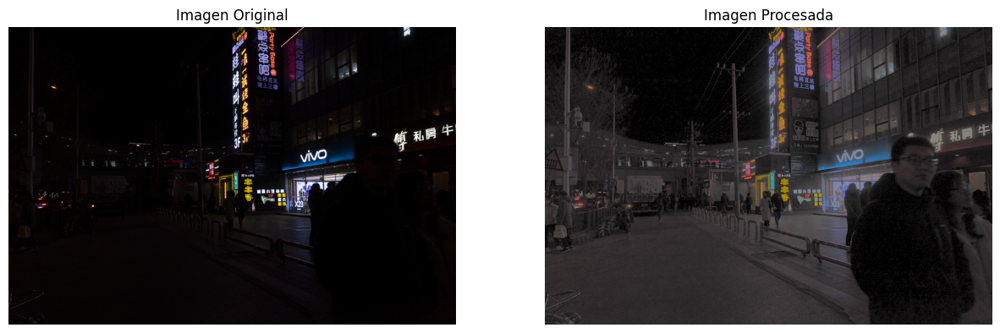

In [351]:
# transformación logaritmica
yuv_1_c = yuv_2.copy()
c = 255 / np.log(1 + np.max(yuv_1_c[:,:,0])) 
c=25
yuv_1_c[:,:,0] = c * np.log(1 + yuv_1_c[:,:,0].astype(float))
yuv_1_c[:,:,0] = np.array(yuv_1_c[:,:,0],dtype=np.uint8)

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_2), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

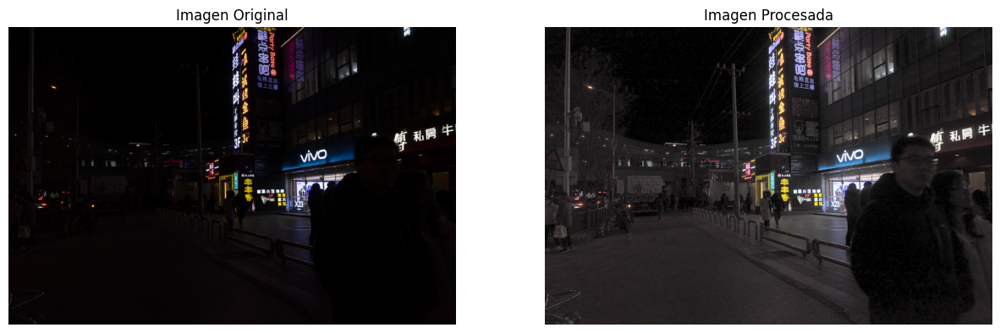

In [352]:
# Ley de potencia (gamma)
yuv_1_c = yuv_2.copy()
gamma = 0.5 # Ajustar este valor
c = 255 / (np.max(yuv_1_c[:,:,0]) ** gamma) 
yuv_1_c[:,:,0] = c * (yuv_1_c[:,:,0].astype(float) ** gamma)
yuv_1_c[:,:,0] = np.array(yuv_1_c[:,:,0], dtype=np.uint8)

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_2), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

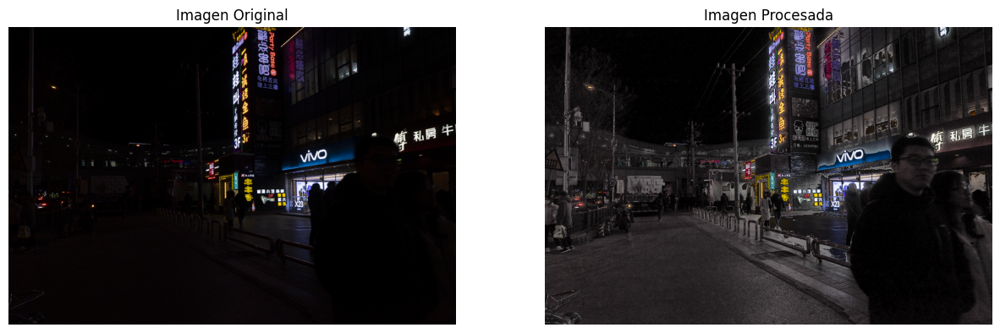

In [353]:
# Función personalizada 1 (transformación lineal por tramos)
def custom_transform(pixel):
    if pixel < 20:
        return int(7 * pixel)  # Reducir intensidad en áreas oscuras
    else:
        return pixel  # Mantener sin cambios

yuv_1_c = yuv_2.copy()
yuv_1_c[:,:,0] = np.array([custom_transform(pixel) for row in yuv_1_c[:,:,0] for pixel in row]).reshape(yuv_1_c[:,:,0].shape)
yuv_1_c[:,:,0] = np.array(yuv_1_c[:,:,0], dtype=np.uint8)

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_2), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

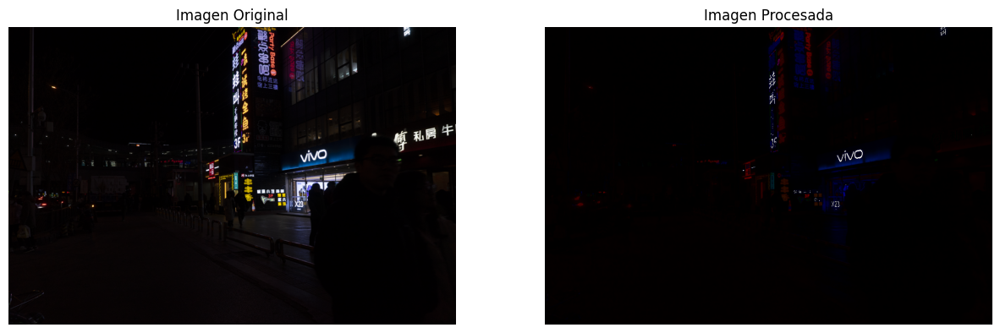

In [354]:
# Función personalizada 2 (transformación basada en seno)
yuv_1_c = yuv_2.copy()

yuv_1_c[:,:,0] = yuv_1_c[:,:,0].astype(np.float32) / 255.0 
yuv_1_c[:,:,0] = 255 * np.sin(np.pi / 2 * yuv_1_c[:,:,0]) 
yuv_1_c[:,:,0] = np.uint8(yuv_1_c[:,:,0])

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_2), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

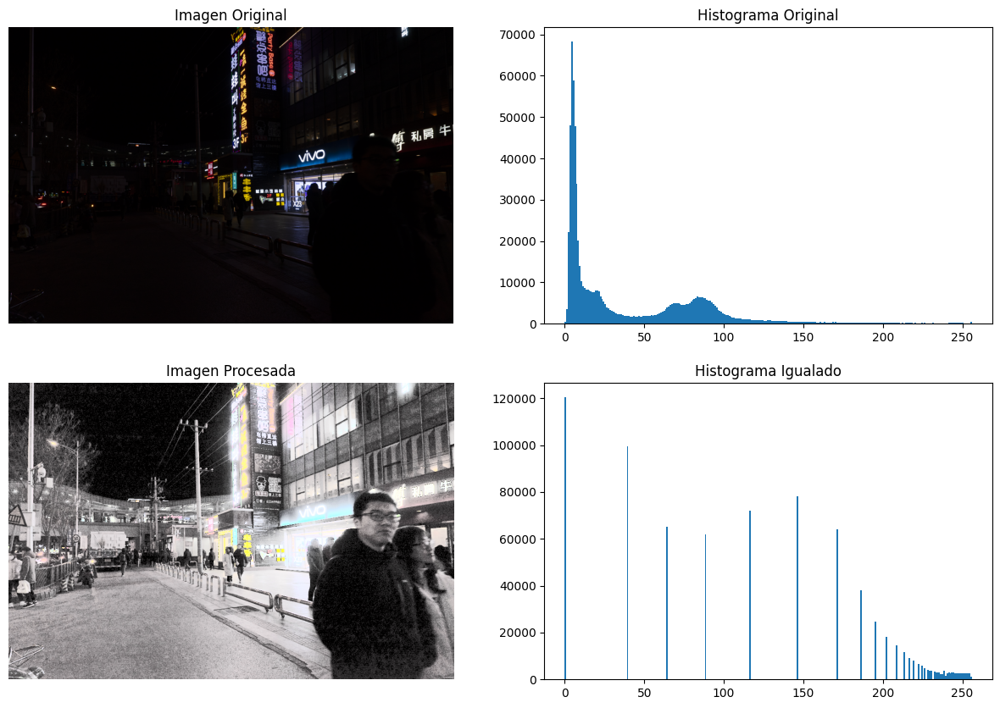

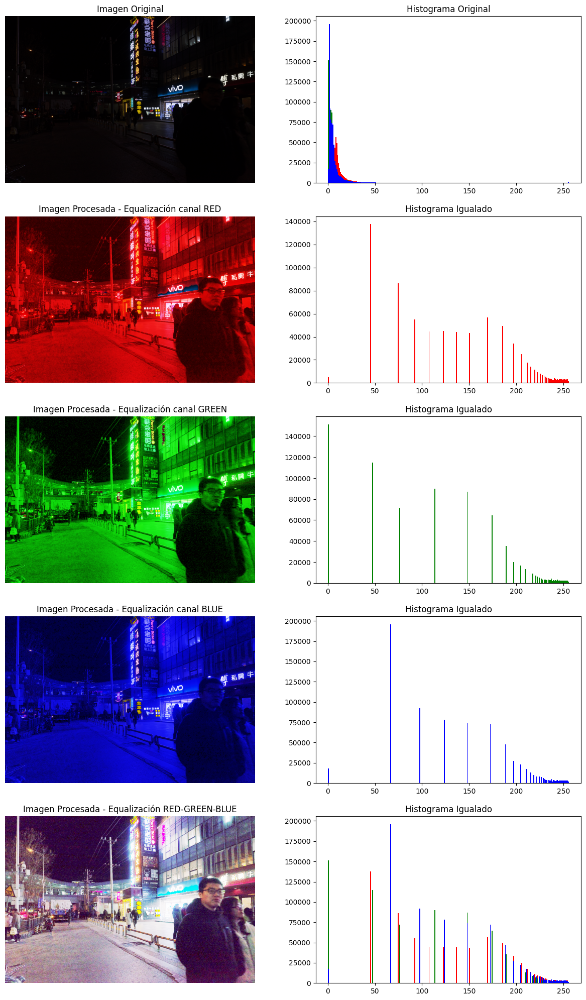

In [355]:
# Igualación del histograma
yuv_1_c = yuv_2.copy()
yuv_1_c[:,:,0] = cv2.equalizeHist(yuv_1_c[:,:,0])

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(2,2,1), plt.title('Imagen Original'), plt.imshow(rgb_2), plt.axis('off')
plt.subplot(2,2,2), plt.title('Histograma Original'), plt.hist(yuv_1[:,:,0].ravel(), 256, range=[0, 256])
plt.subplot(2,2,3), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.subplot(2,2,4), plt.title('Histograma Igualado'), plt.hist(yuv_1_c[:,:,0].ravel(), 256, range=[0, 256])
plt.show()

# RED
rgb_1_r = rgb_2.copy()
rgb_1_r[:,:,0] = cv2.equalizeHist(rgb_1_r[:,:,0])
# GREEN
rgb_1_g = rgb_2.copy()
rgb_1_g[:,:,1] = cv2.equalizeHist(rgb_1_g[:,:,1])
# BLUE
rgb_1_b = rgb_2.copy()
rgb_1_b[:,:,2] = cv2.equalizeHist(rgb_1_b[:,:,2])
# RGB
rgb_1_c = rgb_2.copy()
rgb_1_c[:,:,0] = cv2.equalizeHist(rgb_1_c[:,:,0])
rgb_1_c[:,:,1] = cv2.equalizeHist(rgb_1_c[:,:,1])
rgb_1_c[:,:,2] = cv2.equalizeHist(rgb_1_c[:,:,2])

plt.figure(figsize=(15, 25))
plt.subplot(5,2,1), plt.title('Imagen Original'), plt.imshow(rgb_2), plt.axis('off')
plt.subplot(5,2,2), plt.title('Histograma Original'), plt.hist(rgb_2[:,:,0].ravel(), 256, range=[0, 256],color='r'), plt.hist(rgb_2[:,:,1].ravel(), 256, range=[0, 256],color='g'), plt.hist(rgb_2[:,:,2].ravel(), 256, range=[0, 256],color='b')
plt.subplot(5,2,3), plt.title('Imagen Procesada - Equalización canal RED'), plt.imshow(rgb_1_r), plt.axis('off')
plt.subplot(5,2,4), plt.title('Histograma Igualado'), plt.hist(rgb_1_r[:,:,0].ravel(), 256, range=[0, 256],color='r')
plt.subplot(5,2,5), plt.title('Imagen Procesada - Equalización canal GREEN'), plt.imshow(rgb_1_g), plt.axis('off')
plt.subplot(5,2,6), plt.title('Histograma Igualado'), plt.hist(rgb_1_g[:,:,1].ravel(), 256, range=[0, 256],color='g')
plt.subplot(5,2,7), plt.title('Imagen Procesada - Equalización canal BLUE'), plt.imshow(rgb_1_b), plt.axis('off')
plt.subplot(5,2,8), plt.title('Histograma Igualado'), plt.hist(rgb_1_b[:,:,2].ravel(), 256, range=[0, 256],color='b')
plt.subplot(5,2,9), plt.title('Imagen Procesada - Equalización RED-GREEN-BLUE'), plt.imshow(rgb_1_c), plt.axis('off')
plt.subplot(5,2,10), plt.title('Histograma Igualado'), plt.hist(rgb_1_c[:,:,0].ravel(), 256, range=[0, 256],color='r'), plt.hist(rgb_1_c[:,:,1].ravel(), 256, range=[0, 256],color='g'), plt.hist(rgb_1_c[:,:,2].ravel(), 256, range=[0, 256],color='b')
plt.show()

In [ ]:
# Realce de detalles mediante sustracción

yuv_1_c = yuv_2.copy()
yuv_1_c[:,:,0] = cv2.GaussianBlur(yuv_1_c[:,:,0], (15,15), 0)
yuv_1_c[:,:,0] = cv2.subtract(yuv_2[:,:,0], yuv_1_c[:,:,0])

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_2), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

In [ ]:
# Eliminación de ruido mediante promediado

yuv_1_c = yuv_2.copy()
yuv_1_c[:,:,0] = cv2.blur(yuv_1_c[:,:,0], (10, 10))

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_2), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

## Imagen 3

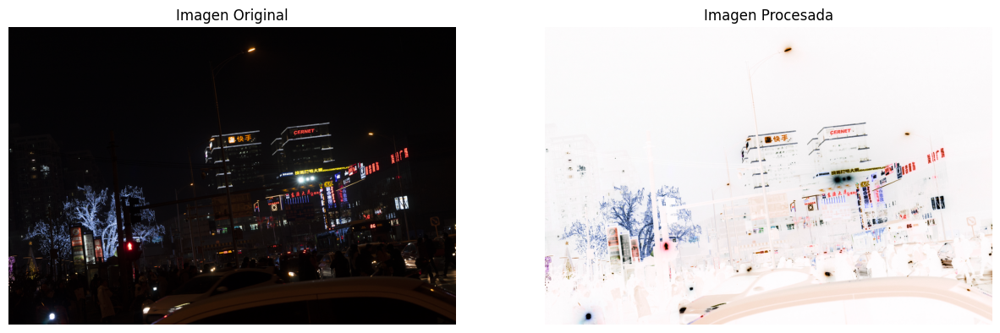

In [358]:
# negativo
yuv_1_c = yuv_3.copy()
yuv_1_c[:,:,0] = 255-yuv_1_c[:,:,0]


rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_3), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

C:\Users\wrfig\AppData\Local\Temp\ipykernel_10500\555566743.py:3: RuntimeWarning: overflow encountered in scalar add
  c = 255 / np.log(1 + np.max(yuv_1_c[:,:,0]))
C:\Users\wrfig\AppData\Local\Temp\ipykernel_10500\555566743.py:3: RuntimeWarning: divide by zero encountered in log
  c = 255 / np.log(1 + np.max(yuv_1_c[:,:,0]))


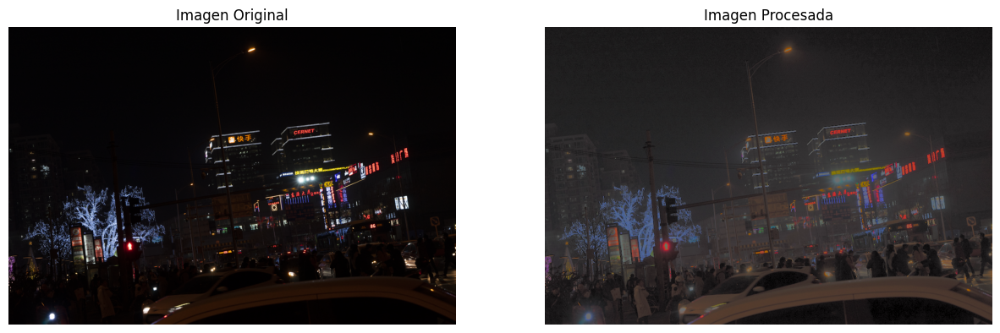

In [359]:
# transformación logaritmica
yuv_1_c = yuv_3.copy()
c = 255 / np.log(1 + np.max(yuv_1_c[:,:,0])) 
c=20
yuv_1_c[:,:,0] = c * np.log(1 + yuv_1_c[:,:,0].astype(float))
yuv_1_c[:,:,0] = np.array(yuv_1_c[:,:,0],dtype=np.uint8)

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_3), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

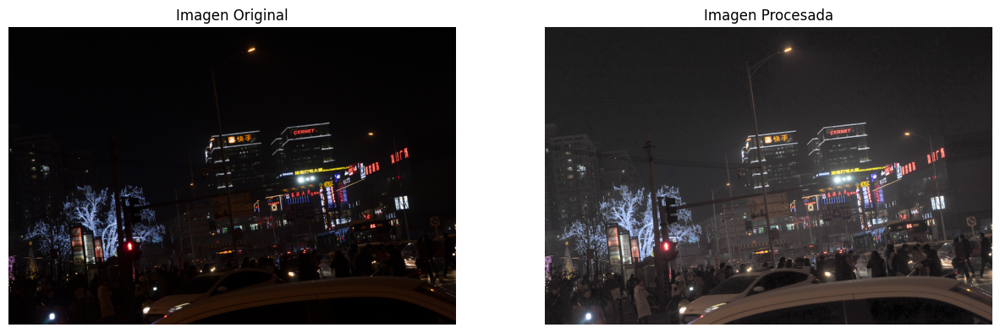

In [360]:
# Ley de potencia (gamma)
yuv_1_c = yuv_3.copy()
gamma = 0.5 # Ajustar este valor
c = 255 / (np.max(yuv_1_c[:,:,0]) ** gamma) 
yuv_1_c[:,:,0] = c * (yuv_1_c[:,:,0].astype(float) ** gamma)
yuv_1_c[:,:,0] = np.array(yuv_1_c[:,:,0], dtype=np.uint8)

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_3), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

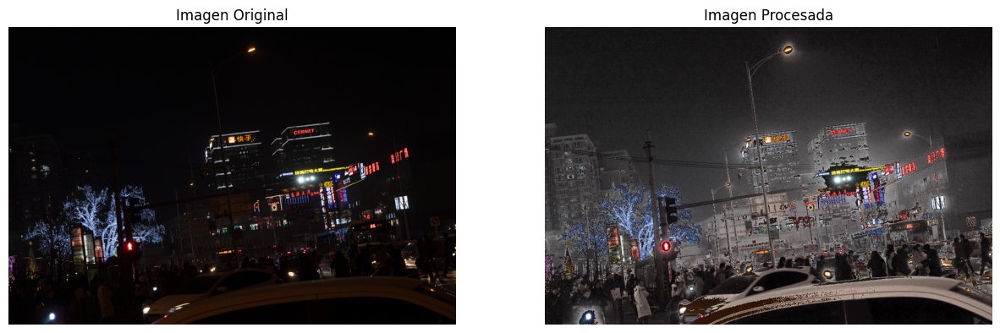

In [361]:
# Función personalizada 1 (transformación lineal por tramos)
def custom_transform(pixel):
    if pixel < 25:
        return int(7 * pixel)  # Reducir intensidad en áreas oscuras
    else:
        return pixel  # Mantener sin cambios

yuv_1_c = yuv_3.copy()
yuv_1_c[:,:,0] = np.array([custom_transform(pixel) for row in yuv_1_c[:,:,0] for pixel in row]).reshape(yuv_1_c[:,:,0].shape)
yuv_1_c[:,:,0] = np.array(yuv_1_c[:,:,0], dtype=np.uint8)

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_3), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

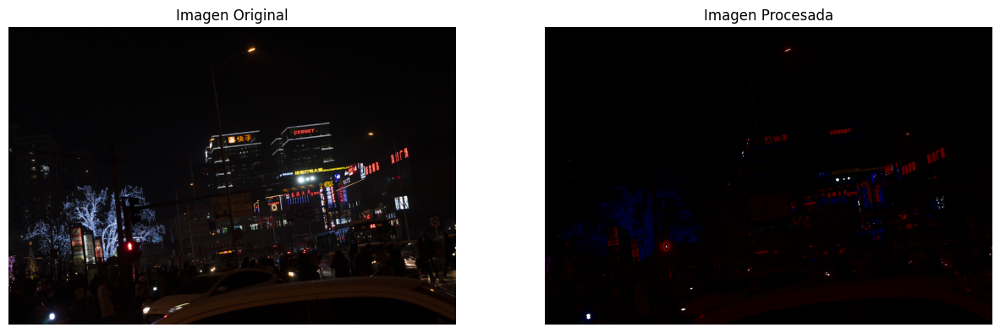

In [362]:
# Función personalizada 2 (transformación basada en seno)
yuv_1_c = yuv_3.copy()

yuv_1_c[:,:,0] = yuv_1_c[:,:,0].astype(np.float32) / 255.0 
yuv_1_c[:,:,0] = 255 * np.sin(np.pi / 2 * yuv_1_c[:,:,0]) 
yuv_1_c[:,:,0] = np.uint8(yuv_1_c[:,:,0])

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_3), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

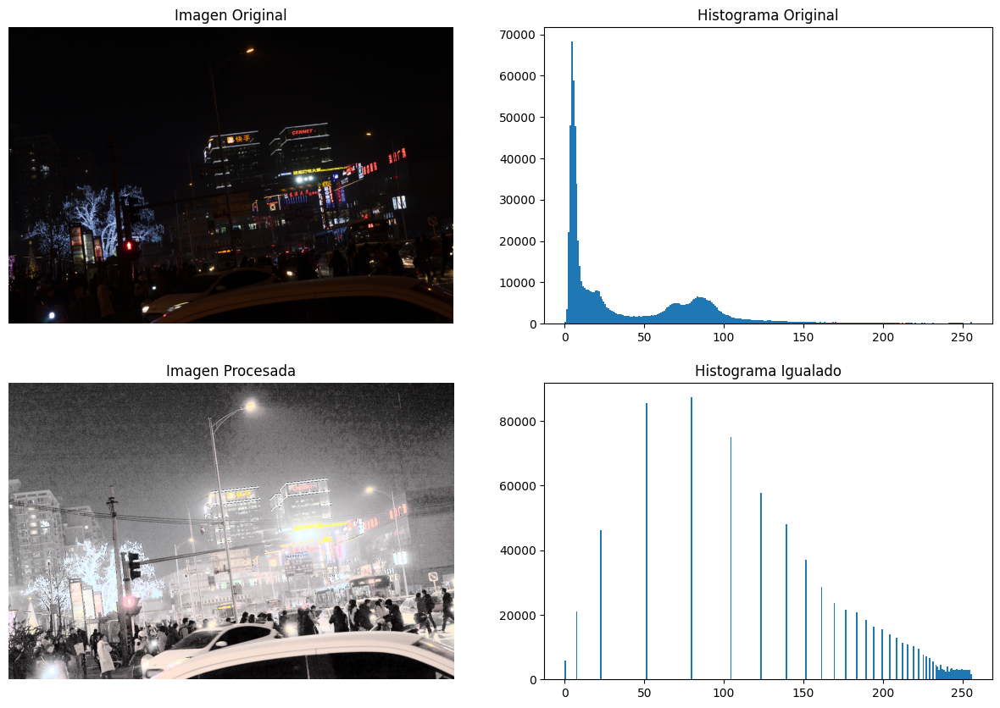

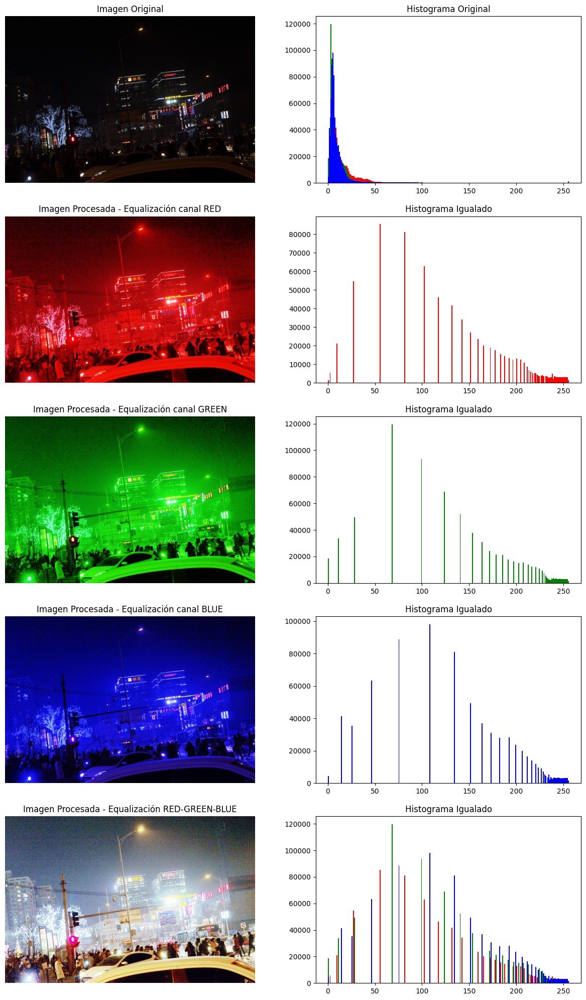

In [363]:
# Igualación del histograma
yuv_1_c = yuv_3.copy()
yuv_1_c[:,:,0] = cv2.equalizeHist(yuv_1_c[:,:,0])

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(2,2,1), plt.title('Imagen Original'), plt.imshow(rgb_3), plt.axis('off')
plt.subplot(2,2,2), plt.title('Histograma Original'), plt.hist(yuv_1[:,:,0].ravel(), 256, range=[0, 256])
plt.subplot(2,2,3), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.subplot(2,2,4), plt.title('Histograma Igualado'), plt.hist(yuv_1_c[:,:,0].ravel(), 256, range=[0, 256])
plt.show()

# RED
rgb_1_r = rgb_3.copy()
rgb_1_r[:,:,0] = cv2.equalizeHist(rgb_1_r[:,:,0])
# GREEN
rgb_1_g = rgb_3.copy()
rgb_1_g[:,:,1] = cv2.equalizeHist(rgb_1_g[:,:,1])
# BLUE
rgb_1_b = rgb_3.copy()
rgb_1_b[:,:,2] = cv2.equalizeHist(rgb_1_b[:,:,2])
# RGB
rgb_1_c = rgb_3.copy()
rgb_1_c[:,:,0] = cv2.equalizeHist(rgb_1_c[:,:,0])
rgb_1_c[:,:,1] = cv2.equalizeHist(rgb_1_c[:,:,1])
rgb_1_c[:,:,2] = cv2.equalizeHist(rgb_1_c[:,:,2])

plt.figure(figsize=(15, 25))
plt.subplot(5,2,1), plt.title('Imagen Original'), plt.imshow(rgb_3), plt.axis('off')
plt.subplot(5,2,2), plt.title('Histograma Original'), plt.hist(rgb_3[:,:,0].ravel(), 256, range=[0, 256],color='r'), plt.hist(rgb_3[:,:,1].ravel(), 256, range=[0, 256],color='g'), plt.hist(rgb_3[:,:,2].ravel(), 256, range=[0, 256],color='b')
plt.subplot(5,2,3), plt.title('Imagen Procesada - Equalización canal RED'), plt.imshow(rgb_1_r), plt.axis('off')
plt.subplot(5,2,4), plt.title('Histograma Igualado'), plt.hist(rgb_1_r[:,:,0].ravel(), 256, range=[0, 256],color='r')
plt.subplot(5,2,5), plt.title('Imagen Procesada - Equalización canal GREEN'), plt.imshow(rgb_1_g), plt.axis('off')
plt.subplot(5,2,6), plt.title('Histograma Igualado'), plt.hist(rgb_1_g[:,:,1].ravel(), 256, range=[0, 256],color='g')
plt.subplot(5,2,7), plt.title('Imagen Procesada - Equalización canal BLUE'), plt.imshow(rgb_1_b), plt.axis('off')
plt.subplot(5,2,8), plt.title('Histograma Igualado'), plt.hist(rgb_1_b[:,:,2].ravel(), 256, range=[0, 256],color='b')
plt.subplot(5,2,9), plt.title('Imagen Procesada - Equalización RED-GREEN-BLUE'), plt.imshow(rgb_1_c), plt.axis('off')
plt.subplot(5,2,10), plt.title('Histograma Igualado'), plt.hist(rgb_1_c[:,:,0].ravel(), 256, range=[0, 256],color='r'), plt.hist(rgb_1_c[:,:,1].ravel(), 256, range=[0, 256],color='g'), plt.hist(rgb_1_c[:,:,2].ravel(), 256, range=[0, 256],color='b')
plt.show()

In [ ]:
# Realce de detalles mediante sustracción

yuv_1_c = yuv_3.copy()
yuv_1_c[:,:,0] = cv2.GaussianBlur(yuv_1_c[:,:,0], (15,15), 0)
yuv_1_c[:,:,0] = cv2.subtract(yuv_3[:,:,0], yuv_1_c[:,:,0])

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_3), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

In [ ]:
# Eliminación de ruido mediante promediado

yuv_1_c = yuv_3.copy()
yuv_1_c[:,:,0] = cv2.blur(yuv_1_c[:,:,0], (10, 10))

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_3), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

## Imagen 4

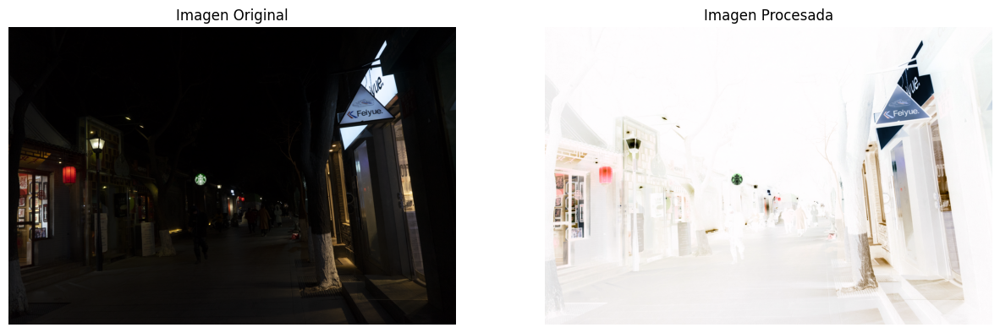

In [366]:
# negativo
yuv_1_c = yuv_4.copy()
yuv_1_c[:,:,0] = 255-yuv_1_c[:,:,0]


rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_4), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

C:\Users\wrfig\AppData\Local\Temp\ipykernel_10500\1398849379.py:3: RuntimeWarning: overflow encountered in scalar add
  c = 255 / np.log(1 + np.max(yuv_1_c[:,:,0]))
C:\Users\wrfig\AppData\Local\Temp\ipykernel_10500\1398849379.py:3: RuntimeWarning: divide by zero encountered in log
  c = 255 / np.log(1 + np.max(yuv_1_c[:,:,0]))


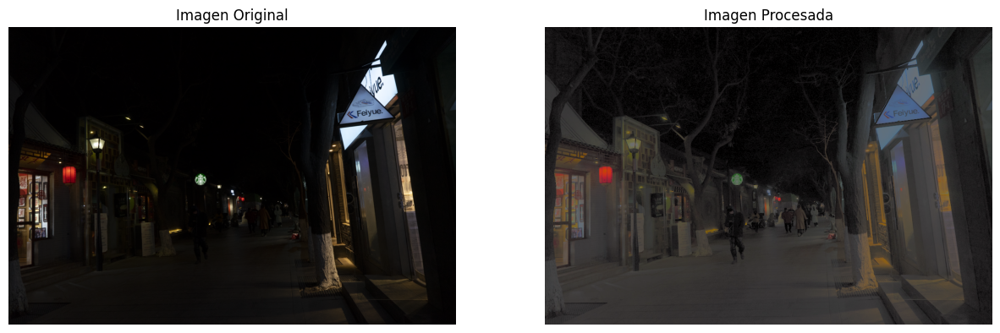

In [367]:
# transformación logaritmica
yuv_1_c = yuv_4.copy()
c = 255 / np.log(1 + np.max(yuv_1_c[:,:,0])) 
c=20
yuv_1_c[:,:,0] = c * np.log(1 + yuv_1_c[:,:,0].astype(float))
yuv_1_c[:,:,0] = np.array(yuv_1_c[:,:,0],dtype=np.uint8)

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_4), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

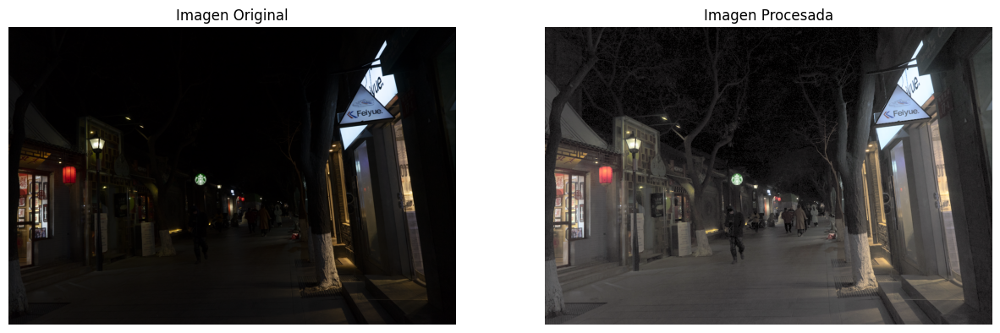

In [368]:
# Ley de potencia (gamma)
yuv_1_c = yuv_4.copy()
gamma = 0.45 # Ajustar este valor
c = 255 / (np.max(yuv_1_c[:,:,0]) ** gamma) 
yuv_1_c[:,:,0] = c * (yuv_1_c[:,:,0].astype(float) ** gamma)
yuv_1_c[:,:,0] = np.array(yuv_1_c[:,:,0], dtype=np.uint8)

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_4), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

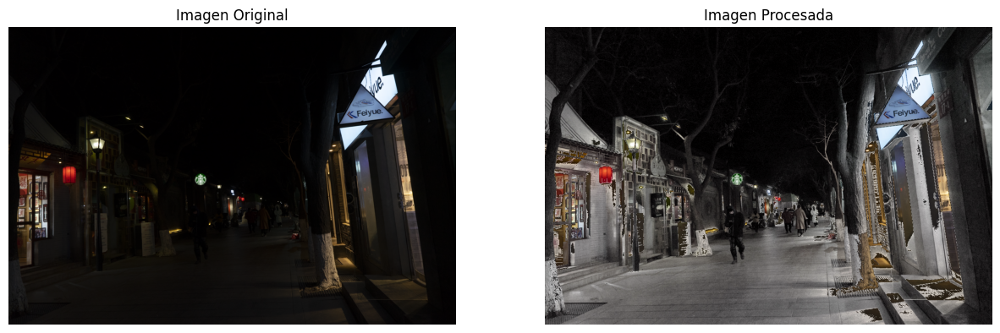

In [369]:
# Función personalizada 1 (transformación lineal por tramos)
def custom_transform(pixel):
    if pixel < 30:
        return int(7 * pixel)  # Reducir intensidad en áreas oscuras
    else:
        return pixel  # Mantener sin cambios

yuv_1_c = yuv_4.copy()
yuv_1_c[:,:,0] = np.array([custom_transform(pixel) for row in yuv_1_c[:,:,0] for pixel in row]).reshape(yuv_1_c[:,:,0].shape)
yuv_1_c[:,:,0] = np.array(yuv_1_c[:,:,0], dtype=np.uint8)

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_4), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

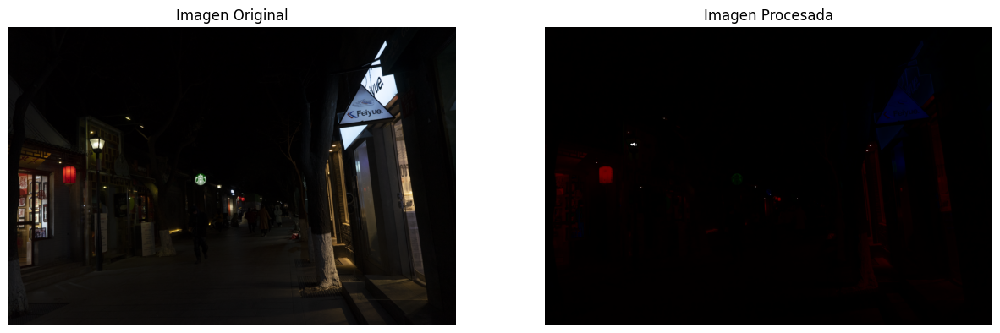

In [370]:
# Función personalizada 2 (transformación basada en seno)
yuv_1_c = yuv_4.copy()

yuv_1_c[:,:,0] = yuv_1_c[:,:,0].astype(np.float32) / 255.0 
yuv_1_c[:,:,0] = 255 * np.sin(np.pi / 2 * yuv_1_c[:,:,0]) 
yuv_1_c[:,:,0] = np.uint8(yuv_1_c[:,:,0])

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_4), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

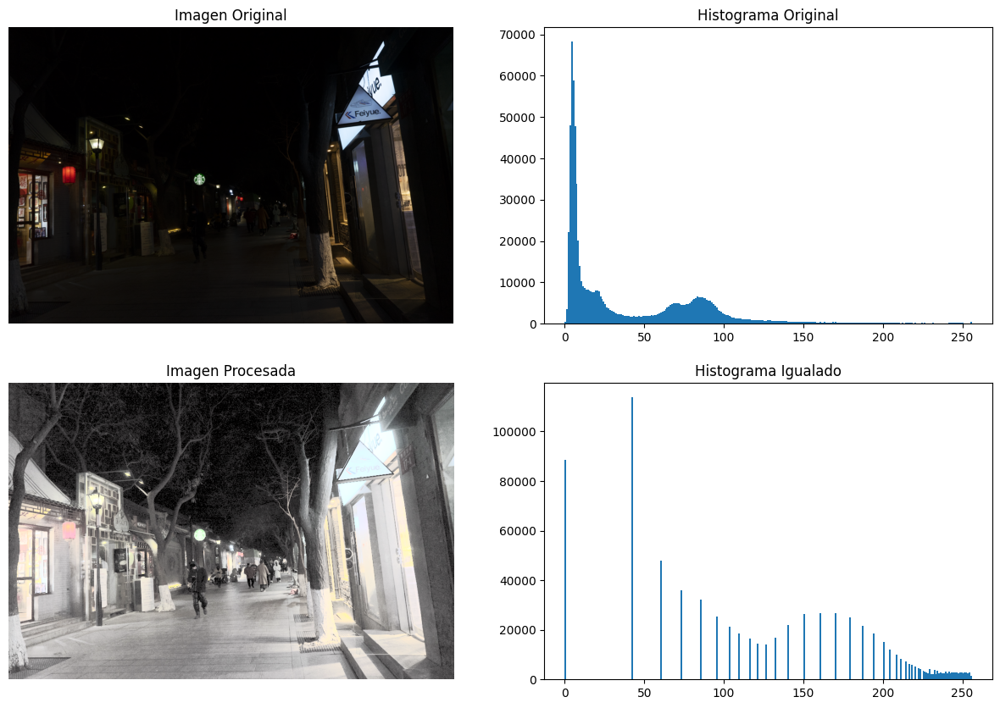

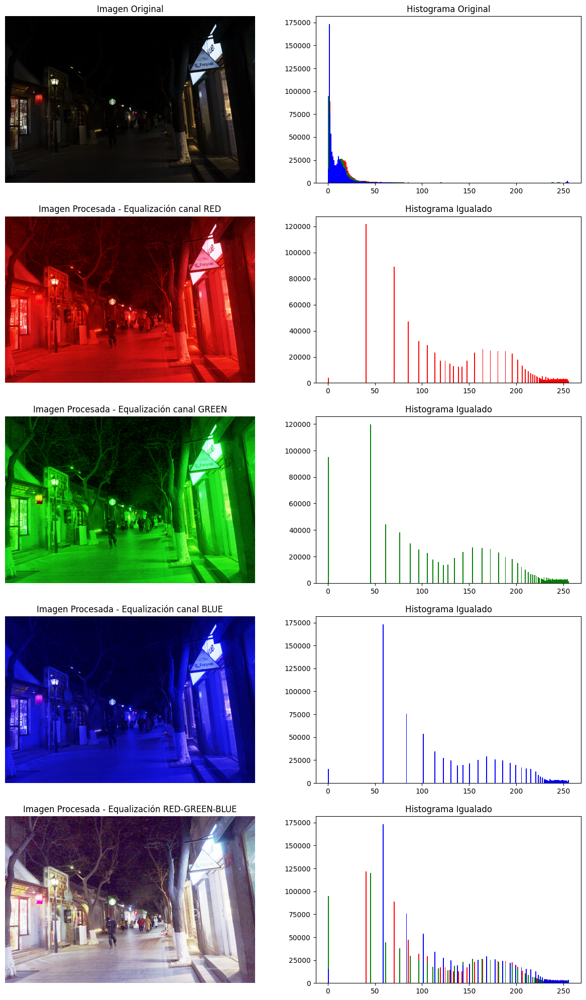

In [371]:
# Igualación del histograma
yuv_1_c = yuv_4.copy()
yuv_1_c[:,:,0] = cv2.equalizeHist(yuv_1_c[:,:,0])

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(2,2,1), plt.title('Imagen Original'), plt.imshow(rgb_4), plt.axis('off')
plt.subplot(2,2,2), plt.title('Histograma Original'), plt.hist(yuv_1[:,:,0].ravel(), 256, range=[0, 256])
plt.subplot(2,2,3), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.subplot(2,2,4), plt.title('Histograma Igualado'), plt.hist(yuv_1_c[:,:,0].ravel(), 256, range=[0, 256])
plt.show()

# RED
rgb_1_r = rgb_4.copy()
rgb_1_r[:,:,0] = cv2.equalizeHist(rgb_1_r[:,:,0])
# GREEN
rgb_1_g = rgb_4.copy()
rgb_1_g[:,:,1] = cv2.equalizeHist(rgb_1_g[:,:,1])
# BLUE
rgb_1_b = rgb_4.copy()
rgb_1_b[:,:,2] = cv2.equalizeHist(rgb_1_b[:,:,2])
# RGB
rgb_1_c = rgb_4.copy()
rgb_1_c[:,:,0] = cv2.equalizeHist(rgb_1_c[:,:,0])
rgb_1_c[:,:,1] = cv2.equalizeHist(rgb_1_c[:,:,1])
rgb_1_c[:,:,2] = cv2.equalizeHist(rgb_1_c[:,:,2])

plt.figure(figsize=(15, 25))
plt.subplot(5,2,1), plt.title('Imagen Original'), plt.imshow(rgb_4), plt.axis('off')
plt.subplot(5,2,2), plt.title('Histograma Original'), plt.hist(rgb_4[:,:,0].ravel(), 256, range=[0, 256],color='r'), plt.hist(rgb_4[:,:,1].ravel(), 256, range=[0, 256],color='g'), plt.hist(rgb_4[:,:,2].ravel(), 256, range=[0, 256],color='b')
plt.subplot(5,2,3), plt.title('Imagen Procesada - Equalización canal RED'), plt.imshow(rgb_1_r), plt.axis('off')
plt.subplot(5,2,4), plt.title('Histograma Igualado'), plt.hist(rgb_1_r[:,:,0].ravel(), 256, range=[0, 256],color='r')
plt.subplot(5,2,5), plt.title('Imagen Procesada - Equalización canal GREEN'), plt.imshow(rgb_1_g), plt.axis('off')
plt.subplot(5,2,6), plt.title('Histograma Igualado'), plt.hist(rgb_1_g[:,:,1].ravel(), 256, range=[0, 256],color='g')
plt.subplot(5,2,7), plt.title('Imagen Procesada - Equalización canal BLUE'), plt.imshow(rgb_1_b), plt.axis('off')
plt.subplot(5,2,8), plt.title('Histograma Igualado'), plt.hist(rgb_1_b[:,:,2].ravel(), 256, range=[0, 256],color='b')
plt.subplot(5,2,9), plt.title('Imagen Procesada - Equalización RED-GREEN-BLUE'), plt.imshow(rgb_1_c), plt.axis('off')
plt.subplot(5,2,10), plt.title('Histograma Igualado'), plt.hist(rgb_1_c[:,:,0].ravel(), 256, range=[0, 256],color='r'), plt.hist(rgb_1_c[:,:,1].ravel(), 256, range=[0, 256],color='g'), plt.hist(rgb_1_c[:,:,2].ravel(), 256, range=[0, 256],color='b')
plt.show()

In [ ]:
# Realce de detalles mediante sustracción

yuv_1_c = yuv_4.copy()
yuv_1_c[:,:,0] = cv2.GaussianBlur(yuv_1_c[:,:,0], (15,15), 0)
yuv_1_c[:,:,0] = cv2.subtract(yuv_4[:,:,0], yuv_1_c[:,:,0])

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_4), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()

In [ ]:
# Eliminación de ruido mediante promediado

yuv_1_c = yuv_4.copy()
yuv_1_c[:,:,0] = cv2.blur(yuv_1_c[:,:,0], (10, 10))

rgb_f_1 = cv2.cvtColor(yuv_1_c,cv2.COLOR_YUV2RGB)
plt.figure(figsize=(15, 10))
plt.subplot(1,2,1), plt.title('Imagen Original'), plt.imshow(rgb_4), plt.axis('off')
plt.subplot(1,2,2), plt.title('Imagen Procesada'), plt.imshow(rgb_f_1), plt.axis('off')
plt.show()